<a href="https://colab.research.google.com/github/devindatt/MMAI894MaskDetection/blob/main/894_Bremner_Mask_Detection_ScaledYOLOv4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Mask Wearing Detection - Transfer Learning on SOTA ScaledYOLOv4 model

* Download mask detection data
* Setup ScaledYOLOv4 Training configuration
* Train model
* Evaluate model training performance
* Visualize annotated training data
* Model inference on test data
* Visualize model inference results
* Evaluate model performance on test data


### Install Model Dependencies

In [15]:
!git clone -b yolov4-large https://github.com/roboflow-ai/ScaledYOLOv4.git  # clone the yolov4-large branch of the open-source ScaledYOLOv4 repo
# Didn't clone the original Wong Kin Yiu's repo - https://github.com/WongKinYiu/ScaledYOLOv4 because it has an issue on runtime with leaf variable.
# Scaled YOLOv4: Scaling Cross Stage Partial Network - https://arxiv.org/abs/2011.08036
%cd /content/ScaledYOLOv4/

Cloning into 'ScaledYOLOv4'...
remote: Enumerating objects: 128, done.
remote: Total 128 (delta 0), reused 0 (delta 0), pack-reused 128
Receiving objects: 100% (128/128), 338.47 KiB | 12.54 MiB/s, done.
Resolving deltas: 100% (52/52), done.
/content/ScaledYOLOv4


In [16]:
import torch
print('Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Using torch 1.8.0+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


In [17]:
%cd /content/
!git clone https://github.com/JunnYu/mish-cuda  #install mish activation funciton for cuda GPU
# Mish is a self-regularized non-monotonic activation function: f(x) = x tanh(softplus(x)); outperformed ReLU and Leaky ReLU - https://arxiv.org/pdf/1908.08681.pdf
%cd mish-cuda
!python setup.py build install

/content
fatal: destination path 'mish-cuda' already exists and is not an empty directory.
/content/mish-cuda
/usr/lib/python3.7/distutils/extension.py:131: UserWarning: Unknown Extension options: 'headers'
  warnings.warn(msg)
running build
running build_py
running egg_info
writing src/mish_cuda.egg-info/PKG-INFO
writing dependency_links to src/mish_cuda.egg-info/dependency_links.txt
writing requirements to src/mish_cuda.egg-info/requires.txt
writing top-level names to src/mish_cuda.egg-info/top_level.txt
/usr/local/lib/python3.7/dist-packages/torch/utils/cpp_extension.py:369: UserWarning: Attempted to use ninja as the BuildExtension backend but we could not find ninja.. Falling back to using the slow distutils backend.
  warnings.warn(msg.format('we could not find ninja.'))
writing manifest file 'src/mish_cuda.egg-info/SOURCES.txt'
running build_ext
running install
running bdist_egg
installing library code to build/bdist.linux-x86_64/egg
running install_lib
creating build/bdist.linux

In [18]:
!pip install -U PyYAML  # PyYAML enables reading the data file

Requirement already up-to-date: PyYAML in /usr/local/lib/python3.7/dist-packages (5.4.1)


### Download Annotated Dataset 

- 1,815 640x640 Preprocessed images (required model input resolution) before augmentation
- 70% Training data (3,804 including augmentation), 20% validation (362 images) and 10% test data (183 images)

In [19]:
%cd /content

!curl -L "https://app.roboflow.com/ds/wIBsLFZkvX?key=huvnv6PNyz" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip;
# download dataset preprocessed with resizing, our Bremner team's manuel annotations, plus augmentations in Roboflow

Streaming output truncated to the last 5000 lines.
 extracting: train/images/983_jpg.rf.7e625149bc740ae399461f9338b8a427.jpg  
 extracting: train/images/984_jpg.rf.2fc398840e64a642bb0c91375daa993a.jpg  
 extracting: train/images/984_jpg.rf.f1c0a59821d345fa1583fe4bcfb04cb8.jpg  
 extracting: train/images/984_jpg.rf.fdc96702f2e5acc77b254eefb68f3fc7.jpg  
 extracting: train/images/986_jpg.rf.2de54ea32ec8ab87c25fc7c2776ee50b.jpg  
 extracting: train/images/986_jpg.rf.55b7acaf1e386e924bf3b02c99ef36f8.jpg  
 extracting: train/images/986_jpg.rf.e25cca973ff2be264267ff1443c985ce.jpg  
 extracting: train/images/988_jpg.rf.0c64b6b1ea864278bc04aab8b56a9e3e.jpg  
 extracting: train/images/988_jpg.rf.1fccc6d8c4106dd809ff497a3623f539.jpg  
 extracting: train/images/988_jpg.rf.d777cf745d214679f135a0b6dbc0c78b.jpg  
 extracting: train/images/98_jpg.rf.4659d2edfe6a3a5c02da047aa4445c2b.jpg  
 extracting: train/images/98_jpg.rf.4bf11a24109d3aa7352d02814c964f81.jpg  
 extracting: train/images/98_jpg.rf.592

In [20]:
%cat data.yaml # view the dataset YAML file

train: ../train/images
val: ../valid/images

nc: 2
names: ['mask', 'no-mask']

In [21]:
%cd /content/
!wget https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/test.yaml

/content
--2021-03-29 04:19:39--  https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/test.yaml
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 75 [text/plain]
Saving to: ‘test.yaml.1’

test.yaml.1         100%[===================>]      75  --.-KB/s    in 0s      

2021-03-29 04:19:40 (3.49 MB/s) - ‘test.yaml.1’ saved [75/75]



In [22]:
%cat test.yaml

test: ../test/images
val: ../test/images

nc: 2
names: ['mask', 'no-mask']


### View Model Configuration and Architecture

In [23]:
%cd /content/ScaledYOLOv4/models/
!wget https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/yolov4-csp-mask.yaml

/content/ScaledYOLOv4/models
--2021-03-29 04:20:00--  https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/yolov4-csp-mask.yaml
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.108.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1606 (1.6K) [text/plain]
Saving to: ‘yolov4-csp-mask.yaml.1’

yolov4-csp-mask.yam 100%[===================>]   1.57K  --.-KB/s    in 0s      

2021-03-29 04:20:00 (41.0 MB/s) - ‘yolov4-csp-mask.yaml.1’ saved [1606/1606]



In [24]:
%cat /content/ScaledYOLOv4/models/yolov4-csp-mask.yaml  # change default number of classes from 80 for COCO dataset to 2 for mask detection
# tried to reduce depth and width multiples as shown later in hyperparameter tuning - performance turned out to be worse than the 1 and 1 for the default configuration

# parameters
nc: 2  # number of classes
depth_multiple: 1.0  # model depth multiple
width_multiple: 1.0  # layer channel multiple

# anchors
anchors:
  - [12,16, 19,36, 40,28]  # P3/8
  - [36,75, 76,55, 72,146]  # P4/16
  - [142,110, 192,243, 459,401]  # P5/32

# yolov4-csp backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [32, 3, 1]],  # 0
   [-1, 1, Conv, [64, 3, 2]],  # 1-P1/2
   [-1, 1, Bottleneck, [64]],
   [-1, 1, Conv, [128, 3, 2]],  # 3-P2/4
   [-1, 2, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 5-P3/8
   [-1, 8, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 7-P4/16
   [-1, 8, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]], # 9-P5/32
   [-1, 4, BottleneckCSP, [1024]],  # 10
  ]

# yolov4-csp head
# na = len(anchors[0])
head:
  [[-1, 1, SPPCSP, [512]], # 11
   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [8, 1, Conv, [256, 1, 1]], # route backbone P4
   [[-1, -2], 1, Concat, [1]],
   [-1, 2, Bottl

In [25]:
%cat /content/ScaledYOLOv4/data/hyp.finetune.yaml  #view the fine-tuned hyperparameters on the COCO dataset

lr0: 0.01  # initial learning rate (SGD=1E-2, Adam=1E-3)
momentum: 0.937  # SGD momentum/Adam beta1
weight_decay: 0.0005  # optimizer weight decay 5e-4
giou: 0.05  # GIoU loss gain
cls: 0.5  # cls loss gain
cls_pw: 1.0  # cls BCELoss positive_weight
obj: 1.0  # obj loss gain (scale with pixels)
obj_pw: 1.0  # obj BCELoss positive_weight
iou_t: 0.20  # IoU training threshold
anchor_t: 4.0  # anchor-multiple threshold
fl_gamma: 0.0  # focal loss gamma (efficientDet default gamma=1.5)
hsv_h: 0.015  # image HSV-Hue augmentation (fraction)
hsv_s: 0.7  # image HSV-Saturation augmentation (fraction)
hsv_v: 0.4  # image HSV-Value augmentation (fraction)
degrees: 0.0  # image rotation (+/- deg)
translate: 0.5  # image translation (+/- fraction)
scale: 0.8  # image scale (+/- gain)
shear: 0.0  # image shear (+/- deg)
perspective: 0.0  # image perspective (+/- fraction), range 0-0.001
flipud: 0.0  # image flip up-down (probability)
fliplr: 0.5  # image flip left-right (probability)
mixup: 0.2  # 

### Train ScaledYOLOv4 Mask Detector

Parameters:
- **img:** input image size
- **batch:** batch size
- **epochs:** number of training epochs
- **data:** path in yaml file
- **cfg:** model configuration
- **weights:** path to weights
- **hyp:** hyperparameters applied in model
- **name:** name for the model results file
- **nosave:** True to only save the final checkpoint
- **cache:** cache images for faster training

Hyperparameters in hyp file:
- **lr0:** initial learning rate
- **momentum**
- **weight_decay**
- **giou**
- **full list in hyp file**

In [12]:
# record time for training ScaledYOLOv4-csp on 10 epochs
# train the base model
%%time
%cd /content/ScaledYOLOv4/
!python train.py --img 640 --batch 8 --epochs 10 --data '../data.yaml' --cfg ./models/yolov4-csp-mask.yaml --weights weights/yolov4-csp.weights  --hyp data/hyp.finetune.yaml  --name yolov4-csp-results  --nosave  --cache
# Adam is False, resulted in better performance than when adam=True
# Can do hyperparameter evolution with --evolve, which uses genetic algorithm for optimization.  However, it's set at default 100 iterations of the best scenario that maximizes fitness, 
# so it's too time and resources consuming to carry out on Colab free tier for this project.  
# If we were given greater dedicated GPU/TPU computing resources and more time, will certainly adopt hyperparameter evolution to find the best tuned hyperparameters. 
# Weights using pre-trained weights found on COCO dataset, better than randomly initialize using --weights ''

/content/ScaledYOLOv4
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Namespace(adam=False, batch_size=8, bucket='', cache_images=True, cfg='./models/yolov4-csp-mask.yaml', data='../data.yaml', device='', epochs=10, evolve=False, global_rank=-1, hyp='data/hyp.finetune.yaml', img_size=[640, 640], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov4-csp-results', noautoanchor=False, nosave=True, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=8, weights='weights/yolov4-csp.weights', world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2021-03-28 22:52:10.064701: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Hyperparameters {'lr0': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma': 0

**Hyperparameter Tuning**
- Reduce model depth and width parameter values in model configuration

In [26]:
%cd /content/ScaledYOLOv4/models/
!wget https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/yolov4-csp-mask-v2.yaml

/content/ScaledYOLOv4/models
--2021-03-29 04:20:52--  https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/yolov4-csp-mask-v2.yaml
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1607 (1.6K) [text/plain]
Saving to: ‘yolov4-csp-mask-v2.yaml’

yolov4-csp-mask-v2. 100%[===================>]   1.57K  --.-KB/s    in 0s      

2021-03-29 04:20:52 (34.3 MB/s) - ‘yolov4-csp-mask-v2.yaml’ saved [1607/1607]



In [27]:
%cat /content/ScaledYOLOv4/models/yolov4-csp-mask-v2.yaml  # modified model configuration with 0.33 of default depth and 0.5 of default width

# parameters
nc: 2  # number of classes
depth_multiple: 0.33 # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [12,16, 19,36, 40,28]  # P3/8
  - [36,75, 76,55, 72,146]  # P4/16
  - [142,110, 192,243, 459,401]  # P5/32

# yolov4-csp backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [32, 3, 1]],  # 0
   [-1, 1, Conv, [64, 3, 2]],  # 1-P1/2
   [-1, 1, Bottleneck, [64]],
   [-1, 1, Conv, [128, 3, 2]],  # 3-P2/4
   [-1, 2, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 5-P3/8
   [-1, 8, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 7-P4/16
   [-1, 8, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]], # 9-P5/32
   [-1, 4, BottleneckCSP, [1024]],  # 10
  ]

# yolov4-csp head
# na = len(anchors[0])
head:
  [[-1, 1, SPPCSP, [512]], # 11
   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [8, 1, Conv, [256, 1, 1]], # route backbone P4
   [[-1, -2], 1, Concat, [1]],
   [-1, 2, Bott

In [18]:
%%time
%cd /content/ScaledYOLOv4/
# hyperparameter tuning - changed architecture cfg to 0.33 of the initial depth and 0.50 of the inital width or layer channels, versus the base model
# performance is worse than base model
!python train.py --img 640 --batch 8 --epochs 10 --data '../data.yaml' --cfg ./models/yolov4-csp-mask-v2.yaml --weights weights/yolov4-csp.weights  --hyp data/hyp.finetune.yaml  --name yolov4-csp-results  --nosave  --cache

/content/ScaledYOLOv4
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Namespace(adam=False, batch_size=8, bucket='', cache_images=True, cfg='./models/yolov4-csp-mask-v2.yaml', data='../data.yaml', device='', epochs=10, evolve=False, global_rank=-1, hyp='data/hyp.finetune.yaml', img_size=[640, 640], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov4-csp-results', noautoanchor=False, nosave=True, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=8, weights='weights/yolov4-csp.weights', world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2021-03-28 23:45:32.469911: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Hyperparameters {'lr0': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma'

- Increase learning rate

In [28]:
%cd /content/ScaledYOLOv4/data/
!wget https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/hyp.finetune-mask.yaml

/content/ScaledYOLOv4/data
--2021-03-29 04:21:12--  https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/hyp.finetune-mask.yaml
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.109.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1026 (1.0K) [text/plain]
Saving to: ‘hyp.finetune-mask.yaml’

hyp.finetune-mask.y 100%[===================>]   1.00K  --.-KB/s    in 0s      

2021-03-29 04:21:12 (66.0 MB/s) - ‘hyp.finetune-mask.yaml’ saved [1026/1026]



In [29]:
%cat /content/ScaledYOLOv4/data/hyp.finetune-mask.yaml  #view the modified hyperparameters which has changed default initial learning rate from 0.01 to 0.03

lr0: 0.03  # initial learning rate (SGD=1E-2, Adam=1E-3)
momentum: 0.937  # SGD momentum/Adam beta1
weight_decay: 0.0005  # optimizer weight decay 5e-4
giou: 0.05  # GIoU loss gain
cls: 0.5  # cls loss gain
cls_pw: 1.0  # cls BCELoss positive_weight
obj: 1.0  # obj loss gain (scale with pixels)
obj_pw: 1.0  # obj BCELoss positive_weight
iou_t: 0.20  # IoU training threshold
anchor_t: 4.0  # anchor-multiple threshold
fl_gamma: 0.0  # focal loss gamma (efficientDet default gamma=1.5)
hsv_h: 0.015  # image HSV-Hue augmentation (fraction)
hsv_s: 0.7  # image HSV-Saturation augmentation (fraction)
hsv_v: 0.4  # image HSV-Value augmentation (fraction)
degrees: 0.0  # image rotation (+/- deg)
translate: 0.5  # image translation (+/- fraction)
scale: 0.8  # image scale (+/- gain)
shear: 0.0  # image shear (+/- deg)
perspective: 0.0  # image perspective (+/- fraction), range 0-0.001
flipud: 0.0  # image flip up-down (probability)
fliplr: 0.5  # image flip left-right (probability)
mixup: 0.2  # 

In [27]:
%%time
%cd /content/ScaledYOLOv4/
# performance improved with learning rate of 0.03
# hyperparameter tuning - increased initial learning rate from 0.01 to 0.03 in hyp.finetune-mask.yaml file.  Tried changing to 0.1, but the lr was too large and went off range
# tried changing learning rate to 0.02, 0.04, 0.06 and performance was worse.  When learning rate was 0.05, the performance was comparable - the mAP0.5 is 0.678 for 10 epochs versus mAP of 0.674 when learning rate was 0.03.
# tried to reduce initial learning rate from 0.01 to 0.001, and the model was learning too slowly, so didn't go with this option
!python train.py --img 416 --batch 5 --epochs 5 --data '../data.yaml' --cfg ./models/yolov4-csp-mask.yaml --weights weights/yolov4-csp.weights  --hyp data/hyp.finetune-mask.yaml  --name yolov4-csp-results  --nosave  --cache

/content/ScaledYOLOv4
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Namespace(adam=False, batch_size=5, bucket='', cache_images=True, cfg='./models/yolov4-csp-mask.yaml', data='../data.yaml', device='', epochs=5, evolve=False, global_rank=-1, hyp='data/hyp.finetune-mask.yaml', img_size=[416, 416], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov4-csp-results', noautoanchor=False, nosave=True, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=5, weights='weights/yolov4-csp.weights', world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2021-03-29 00:30:01.528934: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Hyperparameters {'lr0': 0.03, 'momentum': 0.937, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma

- Increase momentum to 0.95 when learning rate is 0.03

In [ ]:
%cd /content/ScaledYOLOv4/data/
!wget https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/hyp.finetune-mask-v2.yaml

/content/ScaledYOLOv4/data
--2021-03-27 15:10:41--  https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/hyp.finetune-mask-v2.yaml
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.109.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1025 (1.0K) [text/plain]
Saving to: ‘hyp.finetune-mask-v2.yaml’

hyp.finetune-mask-v 100%[===================>]   1.00K  --.-KB/s    in 0s      

2021-03-27 15:10:41 (45.1 MB/s) - ‘hyp.finetune-mask-v2.yaml’ saved [1025/1025]



In [ ]:
%cat /content/ScaledYOLOv4/data/hyp.finetune-mask-v2.yaml  #view the modified hyperparameters which has changed default momentum from 0.937 to 0.95, and default initial learning rate from 0.01 to 0.03

lr0: 0.03  # initial learning rate (SGD=1E-2, Adam=1E-3)
momentum: 0.95  # SGD momentum/Adam beta1
weight_decay: 0.0005  # optimizer weight decay 5e-4
giou: 0.05  # GIoU loss gain
cls: 0.5  # cls loss gain
cls_pw: 1.0  # cls BCELoss positive_weight
obj: 1.0  # obj loss gain (scale with pixels)
obj_pw: 1.0  # obj BCELoss positive_weight
iou_t: 0.20  # IoU training threshold
anchor_t: 4.0  # anchor-multiple threshold
fl_gamma: 0.0  # focal loss gamma (efficientDet default gamma=1.5)
hsv_h: 0.015  # image HSV-Hue augmentation (fraction)
hsv_s: 0.7  # image HSV-Saturation augmentation (fraction)
hsv_v: 0.4  # image HSV-Value augmentation (fraction)
degrees: 0.0  # image rotation (+/- deg)
translate: 0.5  # image translation (+/- fraction)
scale: 0.8  # image scale (+/- gain)
shear: 0.0  # image shear (+/- deg)
perspective: 0.0  # image perspective (+/- fraction), range 0-0.001
flipud: 0.0  # image flip up-down (probability)
fliplr: 0.5  # image flip left-right (probability)
mixup: 0.2  # i

In [ ]:
%%time
%cd /content/ScaledYOLOv4/
# best performance scenario
# hyperparameter tuning - increased momentum from 0.937 to 0.95.  Tried to decrease momentum to 0.85 and the performance was worse. 
# hyperparameter tuning - set initial learning rate at 0.03
!python train.py --img 640 --batch 8 --epochs 15 --data '../data.yaml' --cfg ./models/yolov4-csp-mask.yaml --weights weights/yolov4-csp.weights  --hyp data/hyp.finetune-mask-v2.yaml  --name yolov4-csp-results  --nosave  --cache

/content/ScaledYOLOv4
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Namespace(adam=False, batch_size=8, bucket='', cache_images=True, cfg='./models/yolov4-csp-mask.yaml', data='../data.yaml', device='', epochs=15, evolve=False, global_rank=-1, hyp='data/hyp.finetune-mask-v2.yaml', img_size=[640, 640], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov4-csp-results', noautoanchor=False, nosave=True, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=8, weights='weights/yolov4-csp.weights', world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2021-03-27 18:29:52.377045: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Hyperparameters {'lr0': 0.03, 'momentum': 0.95, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_ga

### Evaluate Model Training Performance

Review Tensorboard metrics on training losses and performance

In [28]:
%load_ext tensorboard
%tensorboard --logdir runs  # logfile is saved in the folder "runs"

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

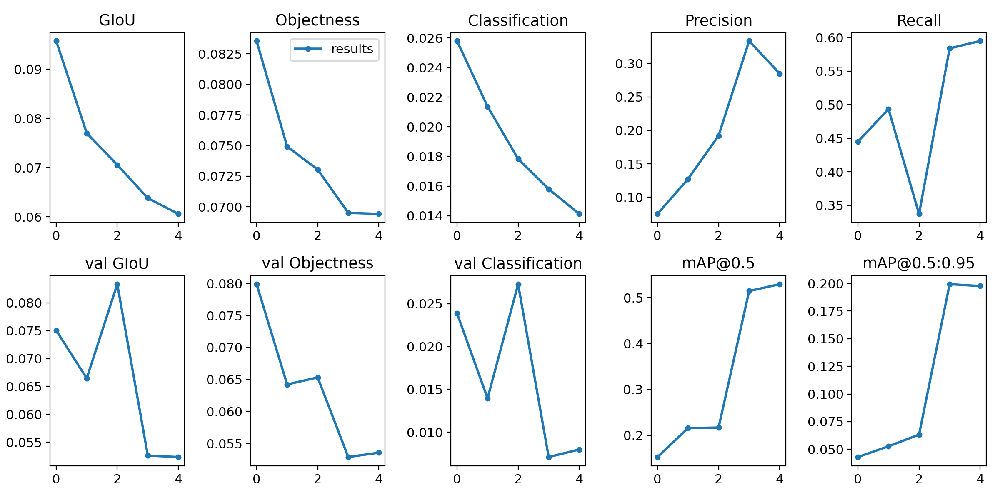

In [29]:
from IPython.display import Image, display
display(Image('/content/ScaledYOLOv4/runs/exp3_yolov4-csp-results/results.png'))  # visualize training results from best hyperparameter-tuned scenario

### Visualize Annotated Data

Ground Truth Training Data:


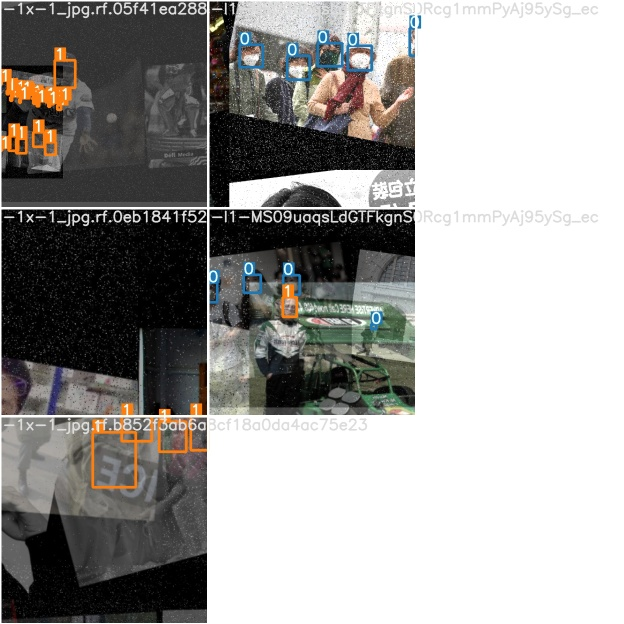

In [30]:
print("Ground Truth Training Data:")
Image(filename='/content/ScaledYOLOv4/runs/exp3_yolov4-csp-results/train_batch0.jpg', width=900)  # show annotated ground truth for training data

Ground Truth Testing Data:


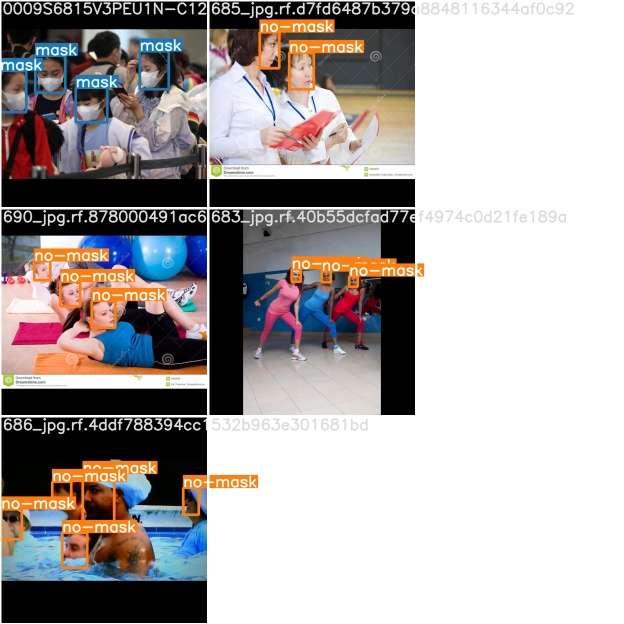

In [31]:
print("Ground Truth Testing Data:")
Image(filename='/content/ScaledYOLOv4/runs/exp3_yolov4-csp-results/test_batch0_gt.jpg', width=900)  # view testing ground truth examples

### Inference Using Trained Weights
Inference prediction using trained final checkpoint on test data images in the `test/images` folder.

In [34]:
%ls runs/  # list files for trained weights that're saved in weights folder

exp0_yolov4-csp-results/  exp2_yolov4-csp-results/
exp1_yolov4-csp-results/  exp3_yolov4-csp-results/


In [35]:
%ls ./runs/exp3_yolov4-csp-results/weights  # list weights for the best hyperparameter-tuned scenario

last_004.pt  last_yolov4-csp-results.pt  last_yolov4-csp-results_strip.pt


In [37]:
%ls ./runs/exp0_yolov4-csp-results/weights 

best_yolov4-csp-results.pt        last_yolov4-csp-results.pt
best_yolov4-csp-results_strip.pt  last_yolov4-csp-results_strip.pt
last_009.pt


In [38]:
%cd /content/ScaledYOLOv4/
!python detect.py --weights ./runs/exp0_yolov4-csp-results/weights/best_yolov4-csp-results.pt --img 640 --conf 0.4 --source ../test/images  
# use the best weights from the best fined-tuned scenario for inference

/content/ScaledYOLOv4
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=640, iou_thres=0.5, output='inference/output', save_txt=False, source='../test/images', update=False, view_img=False, weights=['./runs/exp0_yolov4-csp-results/weights/best_yolov4-csp-results.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Fusing layers... Model Summary: 235 layers, 5.24759e+07 parameters, 5.04494e+07 gradients
image 1/183 /content/test/images/0_Concern-In-China-As-Mystery-Virus-Spreads_jpg.rf.6a92274a43b7299758b7936a2dd51d70.jpg: 640x640 2 masks, Done. (0.039s)
image 2/183 /content/test/images/1018_jpg.rf.99161bb46022b4acf1ca882e1a3f6f63.jpg: 640x640 5 masks, Done. (0.034s)
image 3/183 /content/test/images/101_jpg.rf.048359bf7d5711a875ade59399498cee.jpg: 640x640 1 masks, 6 no-masks, Done. (0.033s)
image 4/183 /content/test/images/1027_jpg.rf.f7478becdfb264312a8875db3e425d53.jpg: 640x640 1 masks, Done. (0.033s)
image

In [14]:
import os
from IPython.display import Image, display
import random

In [45]:
filename = random.choice(os.listdir('./inference/output/'))
print(filename)
Image('./inference/output/' + filename)  # view a randomly selected reference image on test data

compiled_video1.mp4


ValueError: ignored

# **Video Inference**

UPLOAD VIDEO: Upload the test video to the /test/videos/ directory. You might have to make a new 'videos' directory if it is not there, then upload video before running the next cell.

In [30]:
# Make Inference on a test video 
%cd /content/ScaledYOLOv4/
#!python detect.py --weights ./runs/exp0_yolov4-csp-results/weights/best_yolov4-csp-results.pt --img 416 --conf 0.4 --source ../test/videos  
#!python detect.py --weights ./weights/best_yolov4-csp-results.pt --img 416 --conf 0.4 --source ../test/videos/compiled_video2.mp4  
!python detect.py --weights ./weights/best_yolov4-csp-results.pt --img 416 --conf 0.4 --source ../test/videos/compiled_video2.mp4  

# use the best weights from the best fined-tuned scenario for inference

/content/ScaledYOLOv4
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='../test/videos/compiled_video2.mp4', update=False, view_img=False, weights=['./weights/best_yolov4-csp-results.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Traceback (most recent call last):
  File "detect.py", line 171, in <module>
    detect()
  File "detect.py", line 33, in detect
    model = attempt_load(weights, map_location=device)  # load FP32 model
  File "/content/ScaledYOLOv4/models/experimental.py", line 136, in attempt_load
    attempt_download(w)
  File "/content/ScaledYOLOv4/utils/google_utils.py", line 33, in attempt_download
    raise Exception(msg)
Exception: ./weights/best_yolov4-csp-results.pt missing


In [32]:
filename = os.listdir('./inference/output/')
print(filename)

[]


In [46]:
from IPython.display import HTML
from base64 import b64encode

# Input video path

filename = random.choice(os.listdir('./inference/output/'))
print(filename)

save_path = './inference/output/' + filename

# Compressed video path
compressed_path = './inference/output/' + filename +"_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

compiled_video1.mp4


 - **Evaluate Inference Performance on Test Data**

In [ ]:
%cd /content/ScaledYOLOv4/

/content/ScaledYOLOv4


In [ ]:
!python test.py --weights ./runs/exp3_yolov4-csp-results/weights/best_yolov4-csp-results.pt --img 640 --batch 8 --conf 0.001 --data '../test.yaml'  # use best weights for inference performance

Namespace(augment=False, batch_size=8, conf_thres=0.001, data='../test.yaml', device='', img_size=640, iou_thres=0.65, merge=False, save_json=False, save_txt=False, single_cls=False, task='val', verbose=False, weights=['./runs/exp4_yolov4-csp-results/weights/best_yolov4-csp-results.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Fusing layers... Model Summary: 235 layers, 5.24759e+07 parameters, 5.04494e+07 gradients
Scanning labels ../test/labels.cache (181 found, 0 missing, 2 empty, 0 duplicate, for 183 images): 100% 183/183 [00:00<00:00, 15091.87it/s]
               Class      Images     Targets           P           R      mAP@.5  mAP@.5:.95: 100% 23/23 [00:04<00:00,  4.78it/s]
                 all         183    1.12e+03       0.474       0.776       0.733       0.318
Speed: 16.7/1.8/18.5 ms inference/NMS/total per 640x640 image at batch-size 8


In [ ]:
import glob
from IPython.display import Image, display

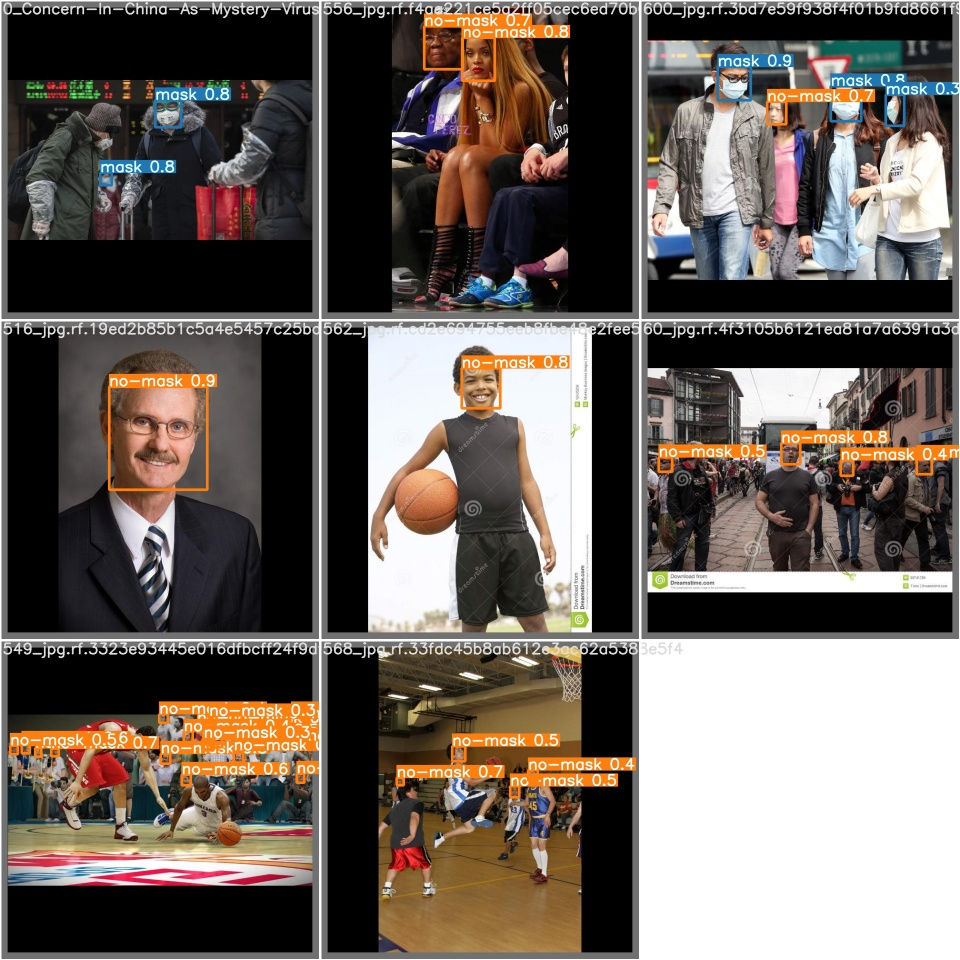

In [ ]:
Image(filename='/content/ScaledYOLOv4//test_batch0_pred.jpg', width=900)  # visualize a few more inference images on test data

### Export Trained Weights for Future Inference on Other Device

In [ ]:
# from google.colab import files
# files.download('./runs/exp4_yolov4-csp-results/weights/best_yolov4-csp-results.pt')